# Imports

In [6]:
%load_ext autoreload
%autoreload 2

import torch
import torch.nn as nn

import torch.nn.functional as F
import numpy as np

import torch.optim as optim
from torch.utils.data import TensorDataset
from torch.utils.data import Dataset, DataLoader
import glob

from torchvision import datasets, transforms
from src.models import linear_vanilla_vae, denoising_vanilla_vae
from src.features import dataLoader as MyDataLoader

from src.features import utils
import pathlib
import PIL
from torchvision.transforms import ToTensor, ToPILImage

import matplotlib.pyplot as plt

import json

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# Early Stopping Script

In [5]:
def PSNR(original, restored):
    mse = np.mean((original - restored) ** 2)
    if(mse == 0):  # MSE is zero means no noise is present in the signal .
                  # Therefore PSNR have no importance.
        return 100
    max_pixel = max(np.unique(restored))
    psnr = 20 * log10(max_pixel / sqrt(mse))
    return psnr

In [8]:
def psnr_array(path_to_folder, image_sample, height, width, gt):
    psnr_list = []
    models_list_length = len(sorted(path_to_folder.rglob("*.net")))
    print(models_list_length)
    for i in range(models_list_length):
        model_name = "epoch-last_vae" + str(i) + ".net"
        net = torch.load(path_to_folder / model_name)
        #output_list = []
        #for patch in patches:
            #patch = patch.view(1,1,height,width).cuda()
            #output = utils.predictMMSE(patch, 10, net, size=(height, width))
            #output_list.append(output)
        output = utils.predictMMSE(image_sample, 10, net, size=(height, width))
        #n = 8
        #noisy_image_patches = []
        #for i in range(n):
            #noisy_image_patches.append(np.concatenate(output_list[i*n:(i+1)*n], axis=1))
        #full_noisy_image = np.concatenate(noisy_image_patches, axis=0)
        psnr_list.append(PSNR(gt, output))
    
    return np.array(psnr_list)

In [9]:
image_path = pathlib.Path("/home/fahad/master_thesis/data/1024x1536/simulated_noisy_templates_without_gaussian_noise/1x/val/87_9_.png")
gt_path = pathlib.Path("/home/fahad/master_thesis/data/1024x1536/simulated_clean_templates/val/87_9_.png")
#x = ToTensor()(PIL.Image.open(image_path).convert("L"))
observation= ToTensor()(PIL.Image.open(image_path).convert("L"))
gt= np.array(PIL.Image.open(gt_path).convert("L"))
height=1536
width=1024
#kh, kw = 192, 128  # kernel size
#dh, dw = 192, 128 # stride

#patches = x.unfold(1, kh, dh).unfold(2, kw, dw)
#patches = patches.contiguous().view(-1, kh, kw)
#height=192
#width=128
image_sample = observation.view(1,1,height,width).cuda()
#image_array = np.array(PIL.Image.open(image_path).convert("L"))

In [10]:
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_16/")
psnr_array_with_gaussian_16_1x = psnr_array(path_to_folder, image_sample, height, width, gt)
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_32/")
psnr_array_with_gaussian_32_1x = psnr_array(path_to_folder, image_sample, height, width, gt)
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_64_v2/")
psnr_array_with_gaussian_64_1x = psnr_array(path_to_folder, image_sample, height, width, gt)

200


/home/fahad/miniconda3/envs/vanilla_vae/lib/python3.7/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


220
200


In [11]:
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_16/")
psnr_array_without_gaussian_16_1x = psnr_array(path_to_folder, image_sample, height, width, gt)
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_32/")
psnr_array_without_gaussian_32_1x = psnr_array(path_to_folder, image_sample, height, width, gt)
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_64/")
psnr_array_without_gaussian_64_1x = psnr_array(path_to_folder, image_sample, height, width, gt)

158
249
186


In [12]:
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/without_gaussian_noise/latent_space_32/")
psnr_array_without_gaussian_32_2x = psnr_array(path_to_folder, image_sample, height, width, gt)
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/without_gaussian_noise/latent_space_64/")
psnr_array_without_gaussian_64_2x = psnr_array(path_to_folder, image_sample, height, width, gt)

150
70


In [13]:
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/with_gaussian_noise/latent_space_32/")
psnr_array_with_gaussian_32_2x = psnr_array(path_to_folder, image_sample, height, width, gt)
path_to_folder = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/with_gaussian_noise/latent_space_64/")
psnr_array_with_gaussian_64_2x = psnr_array(path_to_folder, image_sample, height, width, gt)

150
150


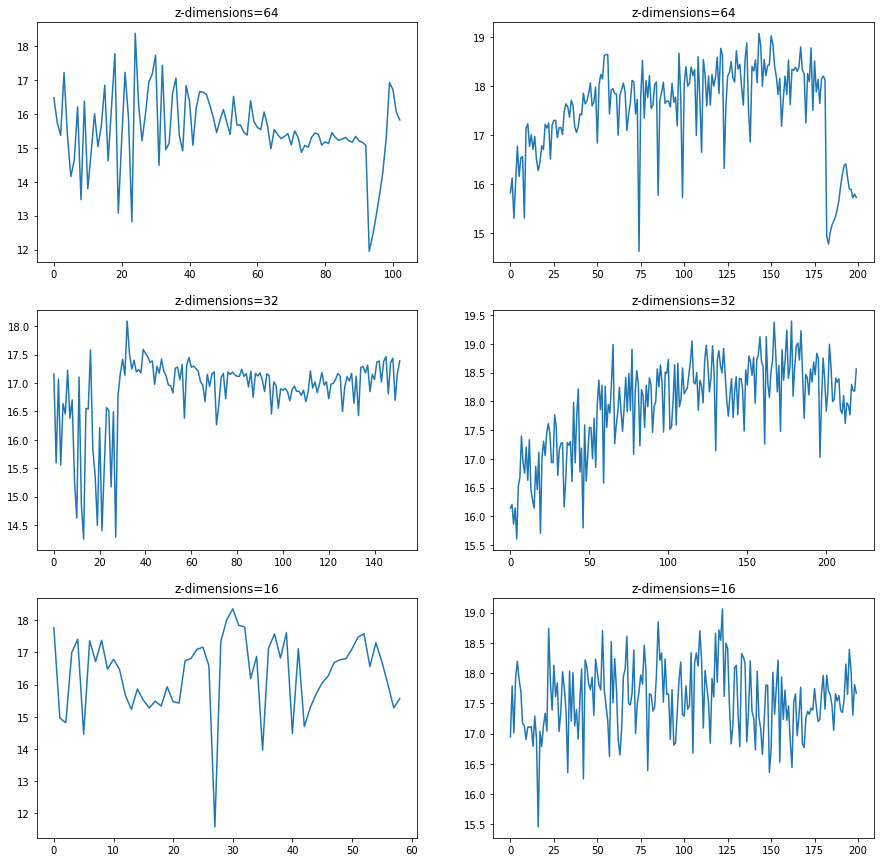

In [14]:
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(15,15))
ax[0, 0].plot(psnr_array_without_gaussian_64_1x)
ax[0, 0].title.set_text("z-dimensions=64")
ax[0, 1].plot(psnr_array_with_gaussian_64_1x)
ax[0, 1].title.set_text("z-dimensions=64")
ax[1, 0].plot(psnr_array_without_gaussian_32_1x)
ax[1, 0].title.set_text("z-dimensions=32")
ax[1, 1].plot(psnr_array_with_gaussian_32_1x)
ax[1, 1].title.set_text("z-dimensions=32")
ax[2, 0].plot(psnr_array_without_gaussian_16_1x)
ax[2, 0].title.set_text("z-dimensions=16")
ax[2, 1].plot(psnr_array_with_gaussian_16_1x)
ax[2, 1].title.set_text("z-dimensions=16")

plt.show()

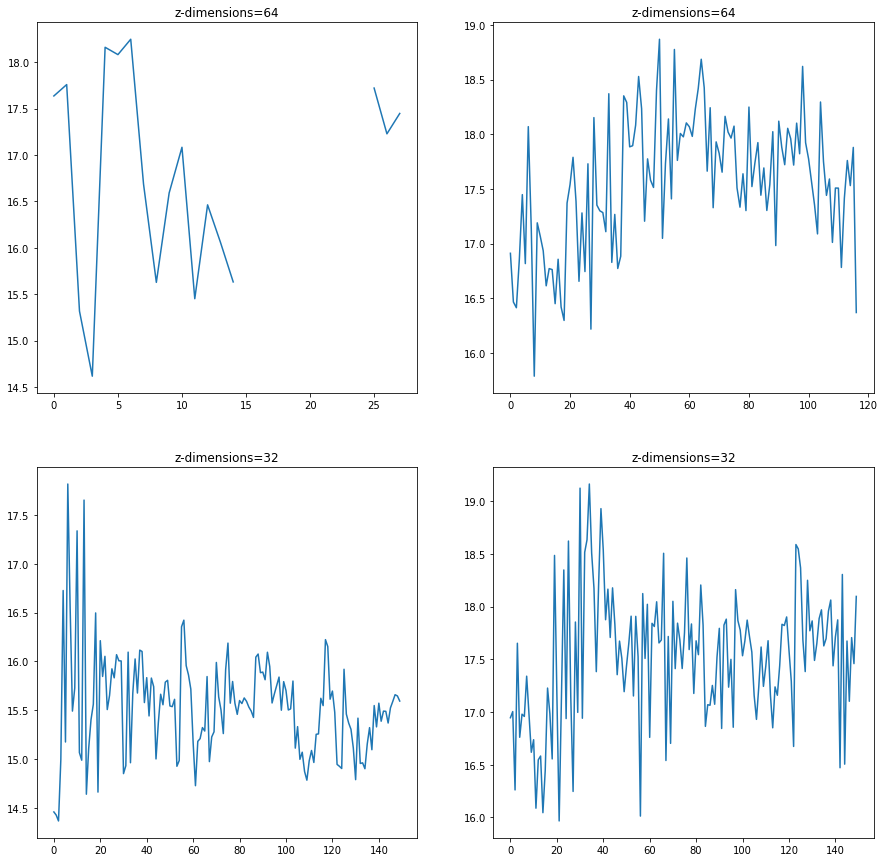

In [15]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(15,15))
ax[0, 0].plot(psnr_array_without_gaussian_64_2x)
ax[0, 0].title.set_text("z-dimensions=64")
ax[0, 1].plot(psnr_array_with_gaussian_64_2x)
ax[0, 1].title.set_text("z-dimensions=64")
ax[1, 0].plot(psnr_array_without_gaussian_32_2x)
ax[1, 0].title.set_text("z-dimensions=32")
ax[1, 1].plot(psnr_array_with_gaussian_32_2x)
ax[1, 1].title.set_text("z-dimensions=32")

plt.show()

# Load Model

In [7]:
net = torch.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/with_gaussian_noise/latent_space_32/epoch-last_vae130.net")

In [35]:
image_path = pathlib.Path("/home/fahad/master_thesis/data/1024x1536/simulated_noisy_templates_without_gaussian_noise/1x/val/86_0_.png")
observation= ToTensor()(PIL.Image.open(image_path).convert("L"))
height=1536
width=1024
image_sample = observation.view(1,1,height,width).cuda()
output = utils.predictMMSE(image_sample, 10, net, size=(height, width))

Text(0.5, 1.0, 'GT')

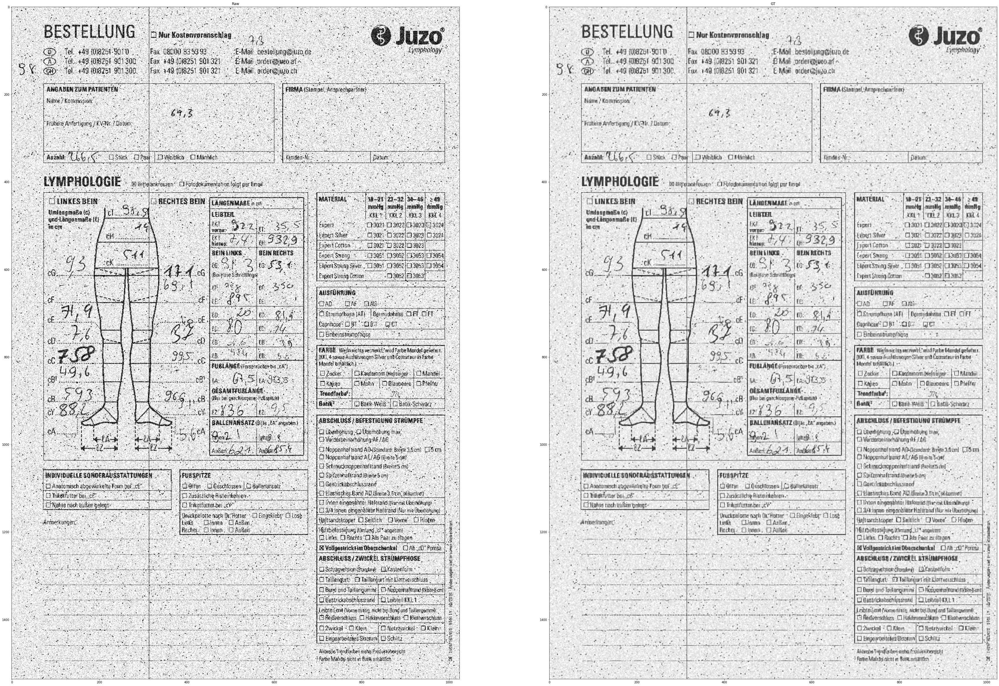

In [151]:
import matplotlib.pyplot as plt
image = plt.imread("/home/fahad/master_thesis/data/1024x1536/simulated_noisy_templates_with_gaussian_noise/2x/val/87_9_.png")
fig=plt.figure(figsize=(60, 60)) 
fig.add_subplot(1, 2, 1)
plt.imshow(image,cmap='gray')
plt.title("Raw")
fig.add_subplot(1, 2, 2)
plt.imshow(output*255,cmap='gray')
plt.title("GT")

Text(0.5, 1.0, 'GT')

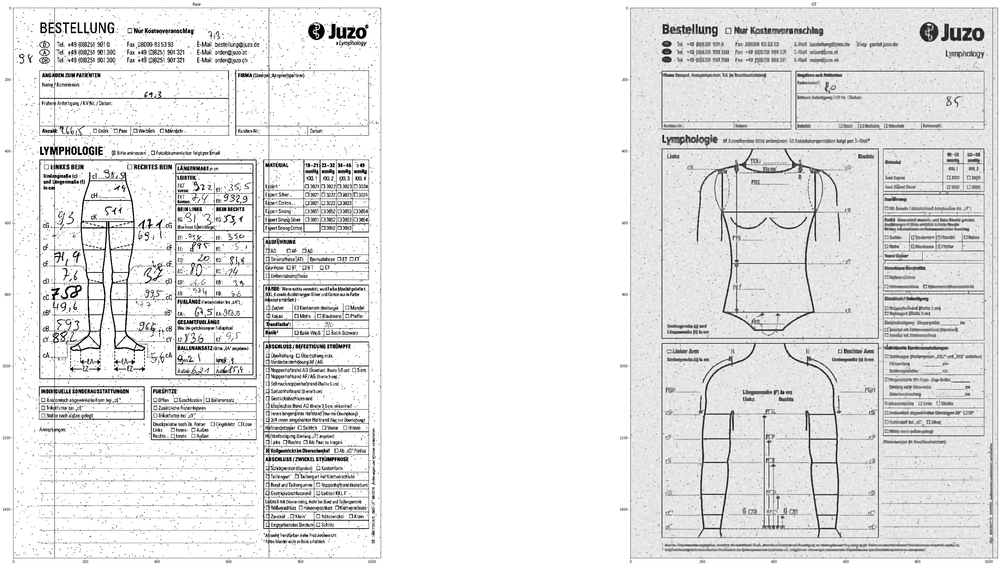

In [34]:
import matplotlib.pyplot as plt
image = plt.imread("/home/fahad/master_thesis/data/1024x1536/simulated_noisy_templates_without_gaussian_noise/val/87_9_.png")
fig=plt.figure(figsize=(60, 30)) 
fig.add_subplot(1, 2, 1)
plt.imshow(image,cmap='gray')
plt.title("Raw")
fig.add_subplot(1, 2, 2)
plt.imshow(output*255,cmap='gray')
plt.title("GT")

Text(0.5, 1.0, 'GT')

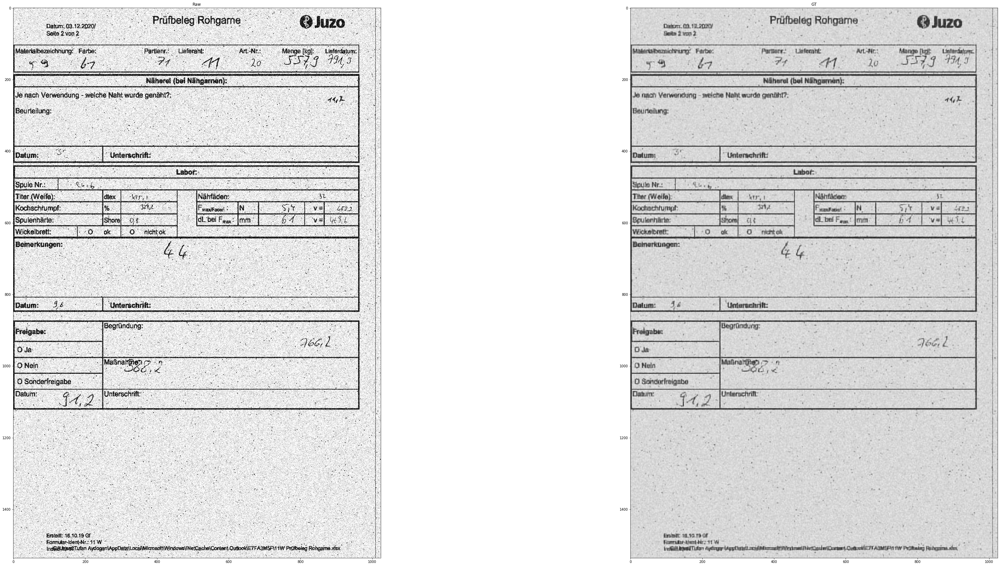

In [10]:
import matplotlib.pyplot as plt
image = plt.imread("/home/fahad/master_thesis/data/simulated_noisy_templates_with_gaussian_noise/val/90_20_.png")
fig=plt.figure(figsize=(60, 30)) 
fig.add_subplot(1, 2, 1)
plt.imshow(image,cmap='gray')
plt.title("Raw")
fig.add_subplot(1, 2, 2)
plt.imshow(output*255,cmap='gray')
plt.title("GT")

# Plot Losses

In [19]:
training_loss_64_with_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_64_v2/train_loss.npy")
val_loss_64_with_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_64_v2//val_loss.npy")

training_loss_64_without_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_64/train_loss.npy")
val_loss_64_without_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_64/val_loss.npy")

training_loss_32_with_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_32/train_loss.npy")
val_loss_32_with_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_32/val_loss.npy")

training_loss_32_without_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_32/train_loss.npy")
val_loss_32_without_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_32/val_loss.npy")

training_loss_16_with_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_16/train_loss.npy")
val_loss_16_with_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/with_gaussian_noise/latent_space_16/val_loss.npy")

training_loss_16_without_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_16/train_loss.npy")
val_loss_16_without_gaussian_1x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_1x/without_gaussian_noise/latent_space_16/val_loss.npy")

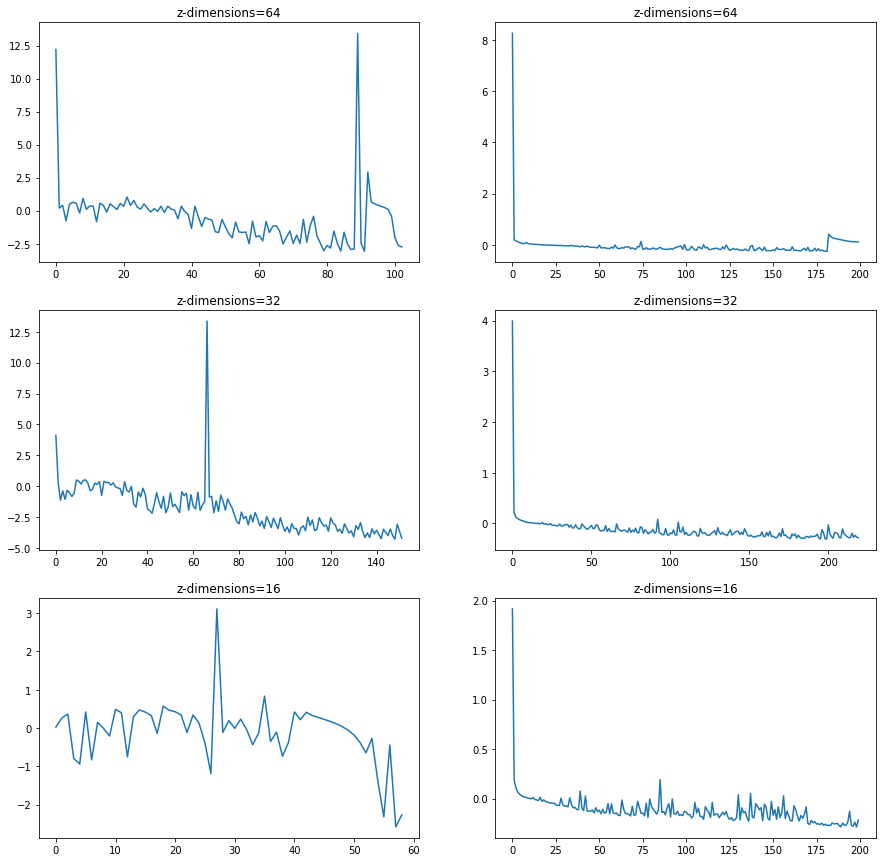

In [100]:
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(15,15))
ax[0, 0].plot(val_loss_64_without_gaussian_1x)
ax[0, 0].title.set_text("z-dimensions=64")
ax[0, 1].plot(val_loss_64_with_gaussian_1x)
ax[0, 1].title.set_text("z-dimensions=64")
ax[1, 0].plot(val_loss_32_without_gaussian_1x)
ax[1, 0].title.set_text("z-dimensions=32")
ax[1, 1].plot(val_loss_32_with_gaussian_1x)
ax[1, 1].title.set_text("z-dimensions=32")
ax[2, 0].plot(val_loss_16_without_gaussian_1x)
ax[2, 0].title.set_text("z-dimensions=16")
ax[2, 1].plot(val_loss_16_with_gaussian_1x)
ax[2, 1].title.set_text("z-dimensions=16")

plt.show()

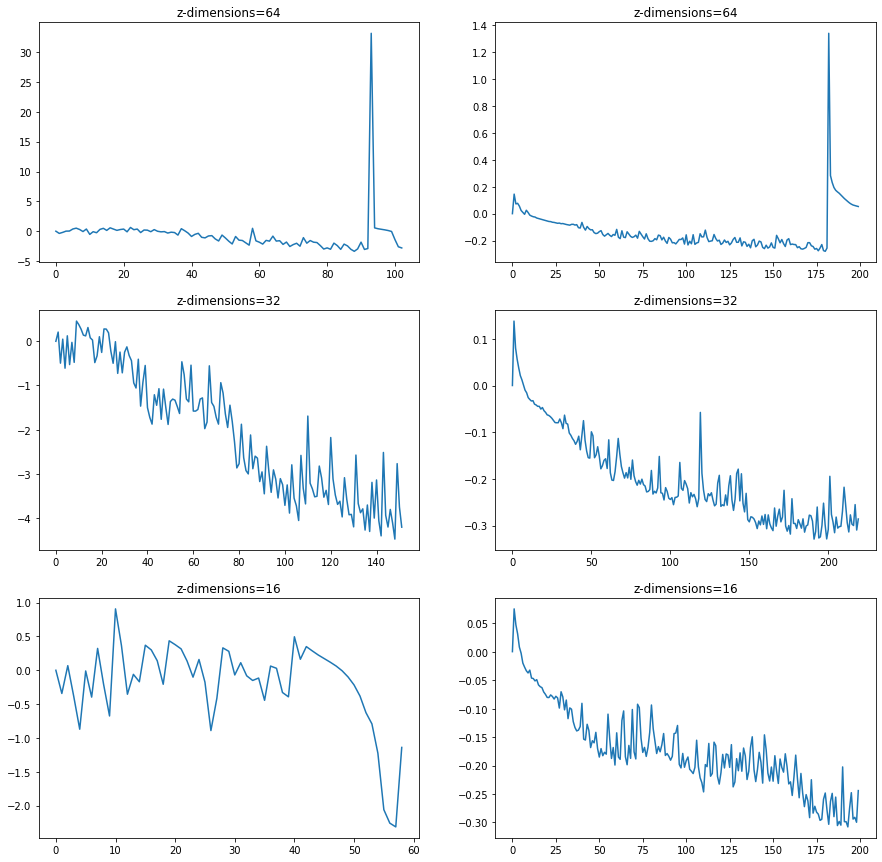

In [20]:
fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(15,15))
ax[0, 0].plot(training_loss_64_without_gaussian_1x)
ax[0, 0].title.set_text("z-dimensions=64")
ax[0, 1].plot(training_loss_64_with_gaussian_1x)
ax[0, 1].title.set_text("z-dimensions=64")
ax[1, 0].plot(training_loss_32_without_gaussian_1x)
ax[1, 0].title.set_text("z-dimensions=32")
ax[1, 1].plot(training_loss_32_with_gaussian_1x)
ax[1, 1].title.set_text("z-dimensions=32")
ax[2, 0].plot(training_loss_16_without_gaussian_1x)
ax[2, 0].title.set_text("z-dimensions=16")
ax[2, 1].plot(training_loss_16_with_gaussian_1x)
ax[2, 1].title.set_text("z-dimensions=16")

plt.show()

In [21]:
training_loss_64_with_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/with_gaussian_noise/latent_space_64/train_loss.npy")
val_loss_64_with_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/with_gaussian_noise/latent_space_64//val_loss.npy")

training_loss_64_without_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/without_gaussian_noise/latent_space_64/train_loss.npy")
val_loss_64_without_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/without_gaussian_noise/latent_space_64/val_loss.npy")

training_loss_32_with_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/with_gaussian_noise/latent_space_32/train_loss.npy")
val_loss_32_with_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/with_gaussian_noise/latent_space_32/val_loss.npy")

training_loss_32_without_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/without_gaussian_noise/latent_space_32/train_loss.npy")
val_loss_32_without_gaussian_2x = np.load("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/without_gaussian_noise/latent_space_32/val_loss.npy")

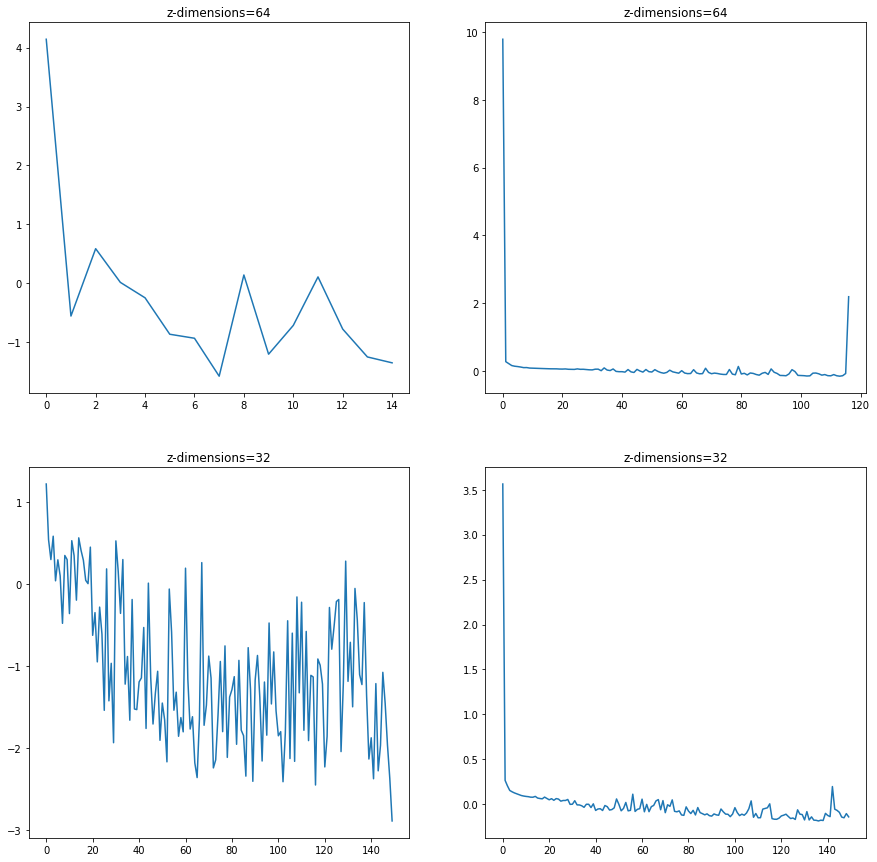

In [22]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(15,15))
ax[0, 0].plot(val_loss_64_without_gaussian_2x)
ax[0, 0].title.set_text("z-dimensions=64")
ax[0, 1].plot(val_loss_64_with_gaussian_2x)
ax[0, 1].title.set_text("z-dimensions=64")
ax[1, 0].plot(val_loss_32_without_gaussian_2x)
ax[1, 0].title.set_text("z-dimensions=32")
ax[1, 1].plot(val_loss_32_with_gaussian_2x)
ax[1, 1].title.set_text("z-dimensions=32")

plt.show()

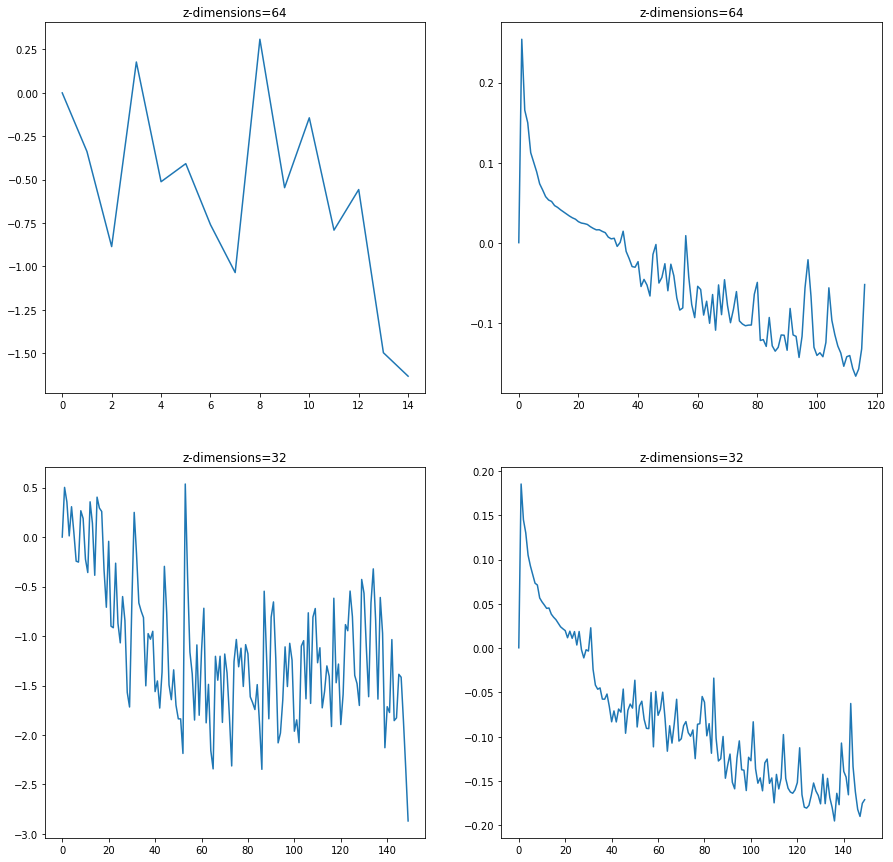

In [23]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(15,15))
ax[0, 0].plot(training_loss_64_without_gaussian_2x)
ax[0, 0].title.set_text("z-dimensions=64")
ax[0, 1].plot(training_loss_64_with_gaussian_2x)
ax[0, 1].title.set_text("z-dimensions=64")
ax[1, 0].plot(training_loss_32_without_gaussian_2x)
ax[1, 0].title.set_text("z-dimensions=32")
ax[1, 1].plot(training_loss_32_with_gaussian_2x)
ax[1, 1].title.set_text("z-dimensions=32")

plt.show()

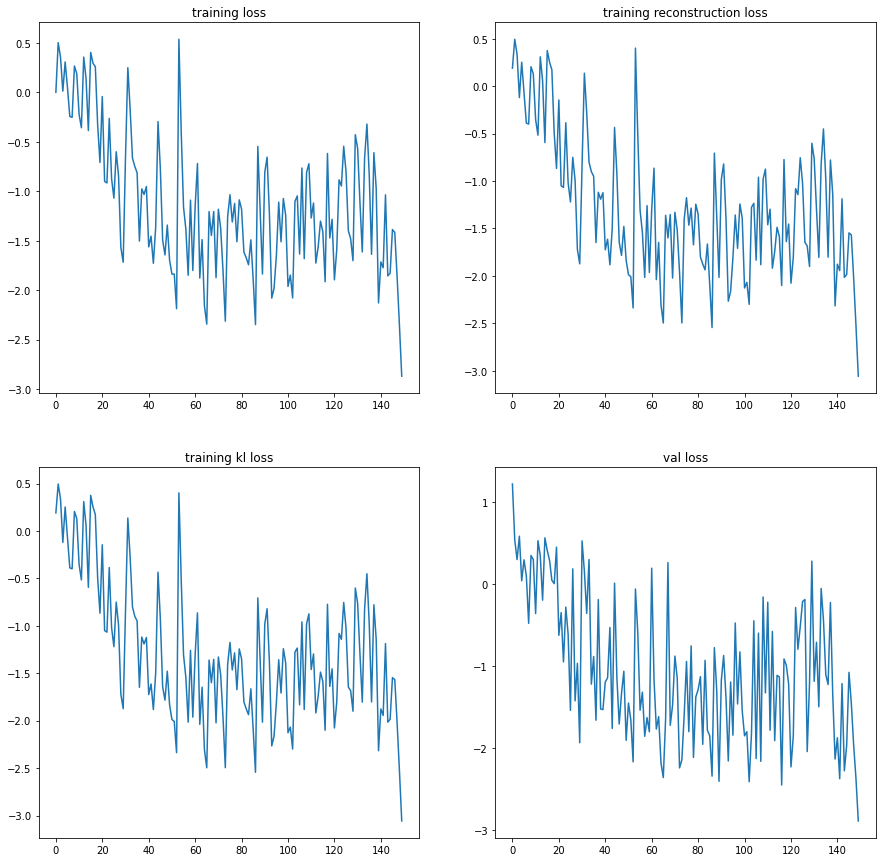

In [94]:
folder_path = pathlib.Path("/home/fahad/master_thesis/vanilla_vae/models/unsupervised/Denoising_Baseline/patched_images_2x/without_gaussian_noise/latent_space_32/")
training_loss = np.load(folder_path / "train_loss.npy")
training_reconstruction_loss = np.load(folder_path / "train_reco_loss.npy")
training_kl_loss = np.load(folder_path / "train_reco_loss.npy")
val_loss = np.load(folder_path / "val_loss.npy")
#Initialized to 0s. Actual values will be appended to matrix by function 
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(15,15))
ax[0, 0].plot(training_loss)
ax[0, 0].title.set_text("training loss")
ax[0, 1].plot(training_reconstruction_loss)
ax[0, 1].title.set_text("training reconstruction loss")
ax[1, 0].plot(training_kl_loss)
ax[1, 0].title.set_text("training kl loss")
ax[1, 1].plot(val_loss)
ax[1, 1].title.set_text("val loss")

plt.show()